# Visualization

In this part we use various libraries to create a graph and visualize it.

In [8]:
import plotly.graph_objects as go
import plotly.io as pio
from tqdm.notebook import tqdm
import plotly.express as px
import pandas as pd
import geopandas as gp
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import math
import json

In [9]:
def make_graph_from_df(df):
    G = nx.from_pandas_edgelist(
        df, 
        source="pickup_loc_id",
        target="dropoff_loc_id",
        edge_attr=True,
        create_using=nx.DiGraph
    )
    return G

In [10]:
def add_coords_to_nodes(G, df_geo):
    for node in G.nodes:
        try:
            G.nodes[node]['pos'] = list(df_geo[df_geo["objectid"] == node].centroid.iloc[0].coords)[0]
            G.nodes[node]['zone'] = df_geo[df_geo["objectid"] == node].zone.iloc[0]
        except:
            G.nodes[node]['pos'] = list(df_geo[df_geo["objectid"] == 1].centroid.iloc[0].coords)[0]
            G.nodes[node]['zone'] = df_geo[df_geo["objectid"] == 1].zone.iloc[0]

In [11]:
def scale_to(array, new_min, new_max, log = False):
    if log:
        if min(array) <= 0:
            old_min = 0
        else:
            old_min = np.log(min(array))
        old_max = np.log(max(array))
        l = []
        for x in array:
            if x <= 0:
                value = 0
            else:
                value = ((new_max - new_min) * (math.log(x) - old_min)) / (old_max - old_min)
            l.append(value)
        return l
    else:
        old_min = min(array)
        old_max = max(array)
        return [((new_max - new_min) * (x - old_min)) / (old_max - old_min) + new_min for x in array]

In [12]:
def draw_graph(G,df_geo, colors, widths, edge_cmap=plt.cm.spring, alpha=1, arrowsize = 1, font_size=12, filename="basic.png", geo_column = "objectid", geo_cmap='Blues'):
    plt.figure(1,figsize=(60,60)) 
    plt.axis('off')

    #nx.draw_networkx_nodes(G, nx.get_node_attributes(G, "pos"), node_size=100, node_color="red")
    nx.draw_networkx_edges(G, nx.get_node_attributes(G, "pos"), edge_cmap=edge_cmap, alpha=alpha, edge_color=colors, width=widths, edge_vmin=0, edge_vmax=1, arrowsize=arrowsize)
    nx.draw_networkx_labels(G, nx.get_node_attributes(G, "pos"), labels = nx.get_node_attributes(G, "zone"), font_size=font_size)
    ax = plt.gca()
    df_geo.plot(ax = ax, column = geo_column, cmap=geo_cmap)
    plt.savefig(filename)
    return None

In [13]:
df_geo = gp.read_file("data/geo_export.shp")
df_edge_summary = pd.read_csv("summary.csv", sep = ";")

In [14]:
G = make_graph_from_df(df_edge_summary)
add_coords_to_nodes(G, df_geo)

Now, just trying out the visualization, and check the highest and bottom edges for future reference.

In [15]:
threshold_bot = 0
threshold_top = 1000
top_n_df =  df_edge_summary.sort_values(by="count", ascending = False)[threshold_bot:threshold_top]
top_n_G = make_graph_from_df(top_n_df)
add_coords_to_nodes(top_n_G, df_geo)
top_n_colors = scale_to([top_n_G[a][b]["count"] for a, b in top_n_G.edges()], 0, 1, log=True)
top_n_widths = scale_to([top_n_G[a][b]["count"] for a, b in top_n_G.edges()], 0.01, 100, log=False)

bot_n_df =  df_edge_summary.sort_values(by="count", ascending = True)[threshold_bot:threshold_top]
bot_n_G = make_graph_from_df(bot_n_df)
add_coords_to_nodes(bot_n_G, df_geo)
bot_n_colors = [bot_n_G[a][b]["count"] for a, b in bot_n_G.edges()]
bot_n_widths = [bot_n_G[a][b]["count"] for a, b in bot_n_G.edges()]

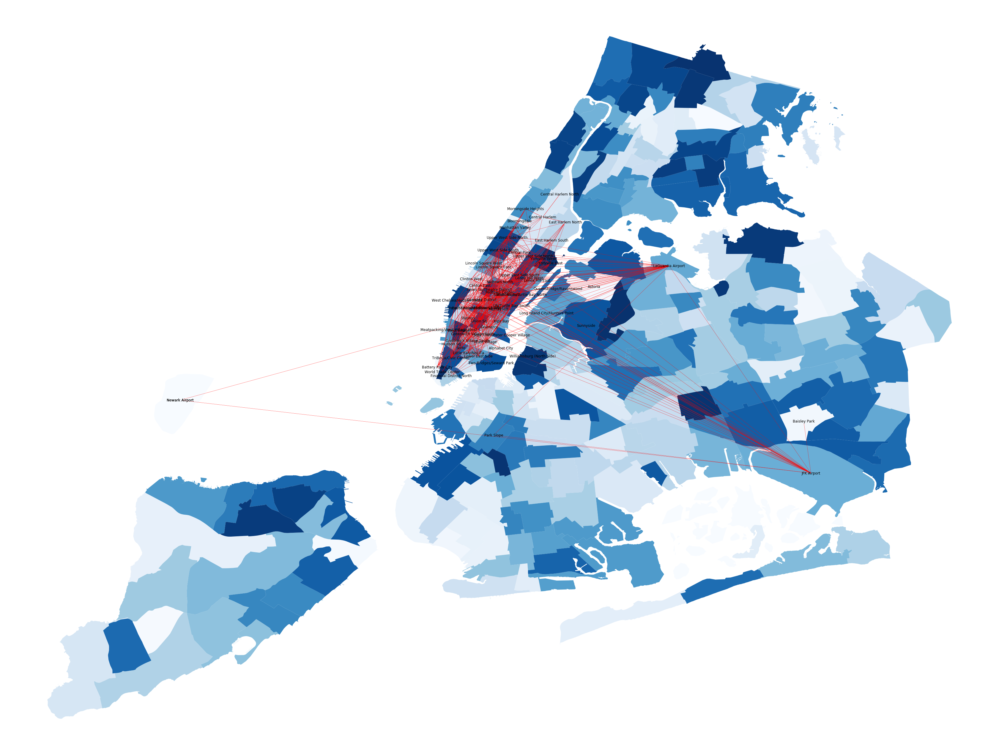

In [16]:
draw_graph(top_n_G, df_geo, colors="Red", widths=0.5, filename="topn.png")

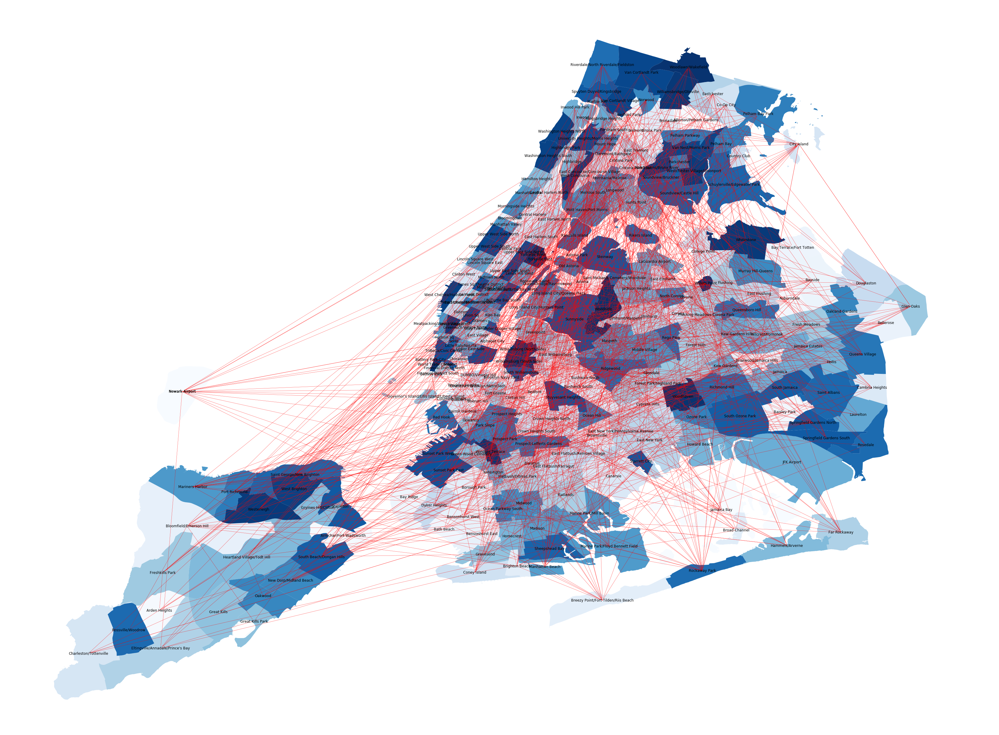

In [17]:
draw_graph(bot_n_G, df_geo, colors="Red", widths=0.5, filename="botn.png")

### Research question: Common zones and connected neighbourhoods


In [18]:
pickup_loc_counts = np.log(df_edge_summary.groupby(by = "pickup_loc_id").sum()["count"])
dropoff_loc_counts = np.log(df_edge_summary.groupby(by = "dropoff_loc_id").sum()["count"])

In [19]:
df_geo_pickup_counts = df_geo.merge(pickup_loc_counts, left_on = "objectid", right_on = "pickup_loc_id")
df_geo_dropoff_counts = df_geo.merge(dropoff_loc_counts,  left_on = "objectid", right_on = "dropoff_loc_id")

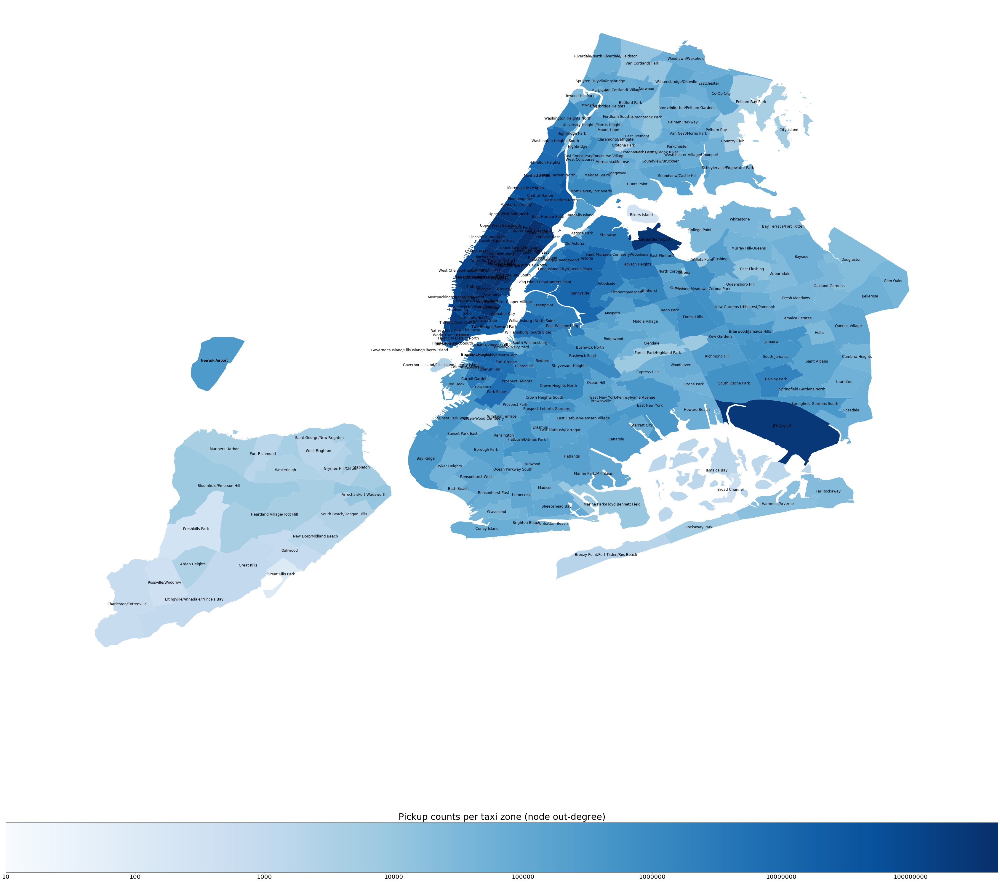

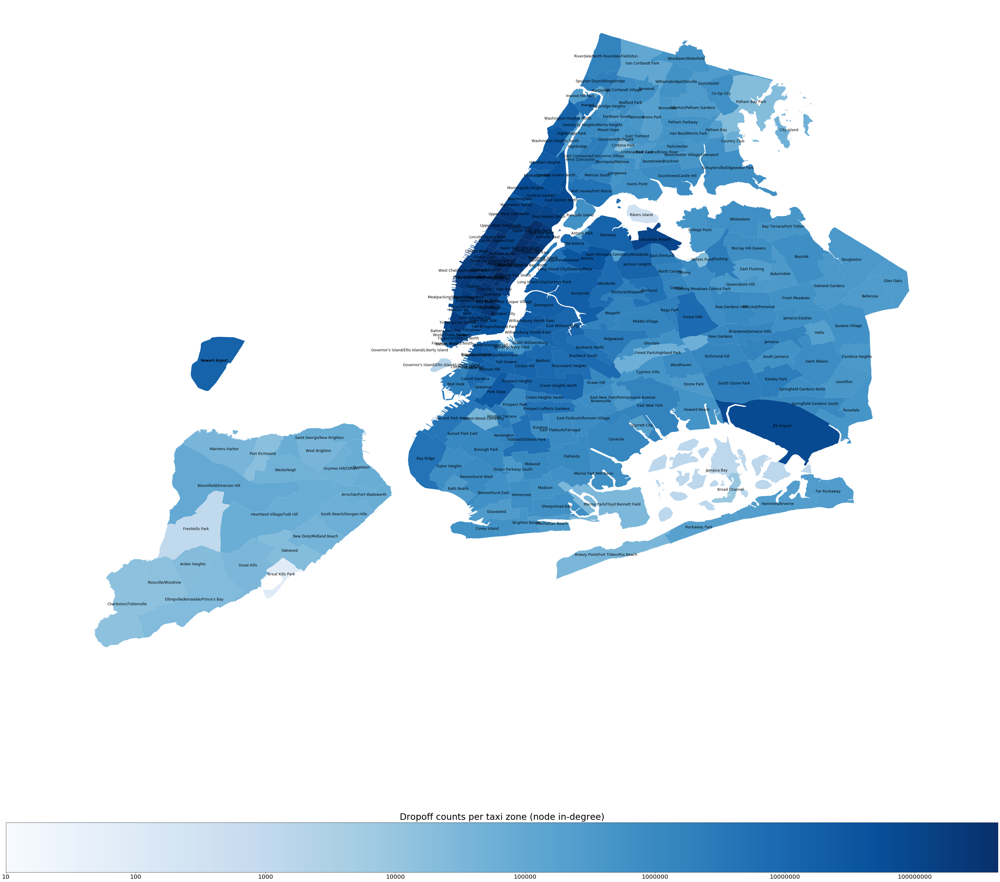

In [20]:
plt.figure(1,figsize=(60,60)) 
plt.axis('off')
nx.draw_networkx_labels(
    G, 
    nx.get_node_attributes(G, "pos"), 
    labels = nx.get_node_attributes(G, "zone"), 
    font_size=12)
ax = plt.gca()
ax = df_geo_pickup_counts.plot(
    ax = ax, 
    column = "count",
    cmap = "Blues", 
    legend = True,
    legend_kwds={
        'orientation': "horizontal"
    }
)
ax.figure.axes[1].set_xlabel("Pickup counts per taxi zone (node out-degree)", fontsize = 30, labelpad = 10)
ax.figure.axes[1].xaxis.set_label_position("top")
ax.figure.axes[1].tick_params(labelsize=20)
ax.figure.axes[1].set_xticklabels(10**np.array(range(1, 10), dtype=int))
plt.savefig("outdegree.png")

plt.figure(2,figsize=(60,60)) 
plt.axis('off')
nx.draw_networkx_labels(
    G, 
    nx.get_node_attributes(G, "pos"), 
    labels = nx.get_node_attributes(G, "zone"), 
    font_size=12
)
ax = plt.gca()
ax = df_geo_dropoff_counts.plot(
    ax = ax, 
    column = "count", 
    cmap = "Blues", 
    legend = True, 
    legend_kwds={
        'orientation': "horizontal"
    }
)
ax.figure.axes[1].set_xlabel("Dropoff counts per taxi zone (node in-degree)", fontsize = 30, labelpad = 10)
ax.figure.axes[1].xaxis.set_label_position("top")
ax.figure.axes[1].tick_params(labelsize=20)
ax.figure.axes[1].set_xticklabels(10**np.array(range(1, 10), dtype=int))
plt.savefig("indegree.png")

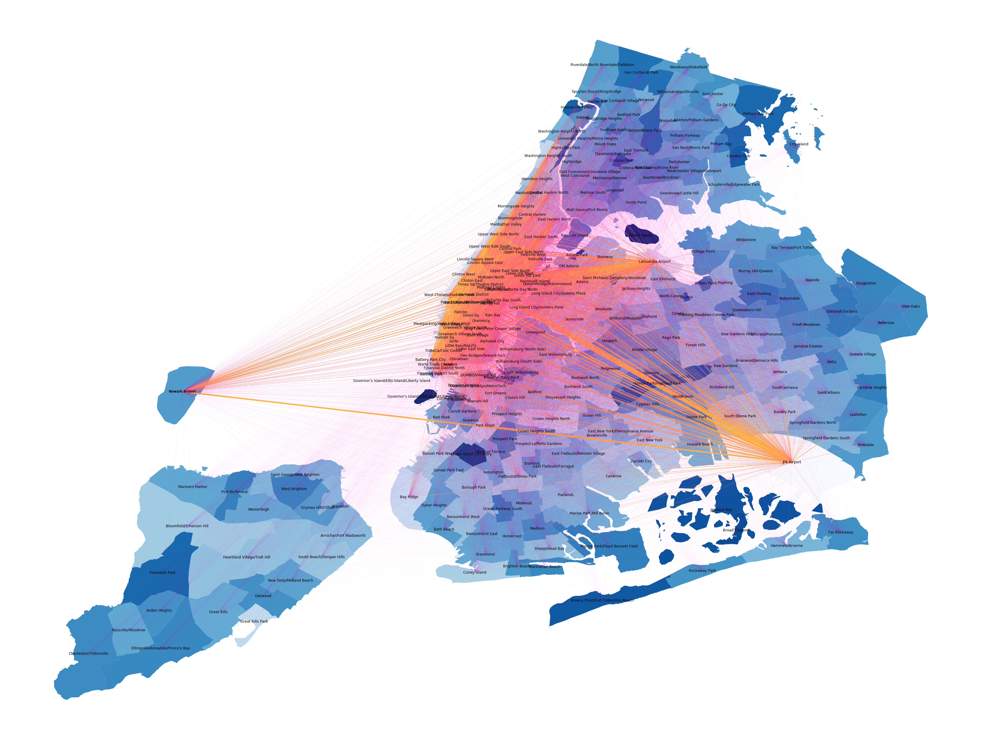

In [21]:
ce = nx.clustering(G)

colors = scale_to([G[a][b]["count"] for a, b in G.edges()], 0, 1, log=True)
widths = scale_to([G[a][b]["count"] for a, b in G.edges()], 0.01, 100, log=False)

s = pd.Series(ce, name='CE').sort_values()
s.index.name = 'id'
s.reset_index()
s = s.replace(0, list(s)[1])

old_min = min(s)
old_max = max(s)
s = s.apply(lambda x: ((1 - 0) * (x - old_min)) / (old_max - old_min) + 0)

df_connection = df_geo.merge(s, left_on = "objectid", right_on = "id")
draw_graph(G, df_connection, colors=colors, widths=widths, geo_column='CE', filename='strong_and_weak.png')

### Research question: Network structure evolvement

In [22]:
id_columns = ["dropoff_loc_id", "pickup_loc_id"]
month_columns = [f"month_{i}_count" for i in range(1, 12 + 1)]
hour_columns = [f"hour_{i}_count" for i in range(24)]

In [23]:
df_scaled_month_count = (df_edge_summary[month_columns] - df_edge_summary[month_columns].min()) / (df_edge_summary[month_columns].max() - df_edge_summary[month_columns].min())
df_scaled_hour_count = (df_edge_summary[hour_columns] - df_edge_summary[hour_columns].min()) / (df_edge_summary[hour_columns].max() - df_edge_summary[hour_columns].min())

In [24]:
df_edge_summary["month_var"] = df_scaled_month_count.var(axis = 1)
df_edge_summary["hour_var"] = df_scaled_hour_count.var(axis = 1)

In [25]:
def plot_top_bot_n_grpah(df, var, geo, bot = 0, top = 100):
    top_n_df =  df.sort_values(by=var, ascending = False)[bot:top]
    top_n_G = make_graph_from_df(top_n_df)
    add_coords_to_nodes(top_n_G, geo)
    top_n_colors = [top_n_G[a][b][var] for a, b in top_n_G.edges()]
    top_n_widths = [top_n_G[a][b][var] for a, b in top_n_G.edges()]
    draw_graph(top_n_G, geo, colors=top_n_colors, widths=1, filename=f"top_n_{var}.png")

    bot_n_df =  df.sort_values(by=var, ascending = True)[bot:top]
    bot_n_G = make_graph_from_df(bot_n_df)
    add_coords_to_nodes(bot_n_G, geo)
    bot_n_colors = [bot_n_G[a][b][var] for a, b in bot_n_G.edges()]
    bot_n_widths = [bot_n_G[a][b][var] for a, b in bot_n_G.edges()]
    draw_graph(bot_n_G, geo, colors=bot_n_colors, widths=1, filename=f"bot_n_{var}.png")

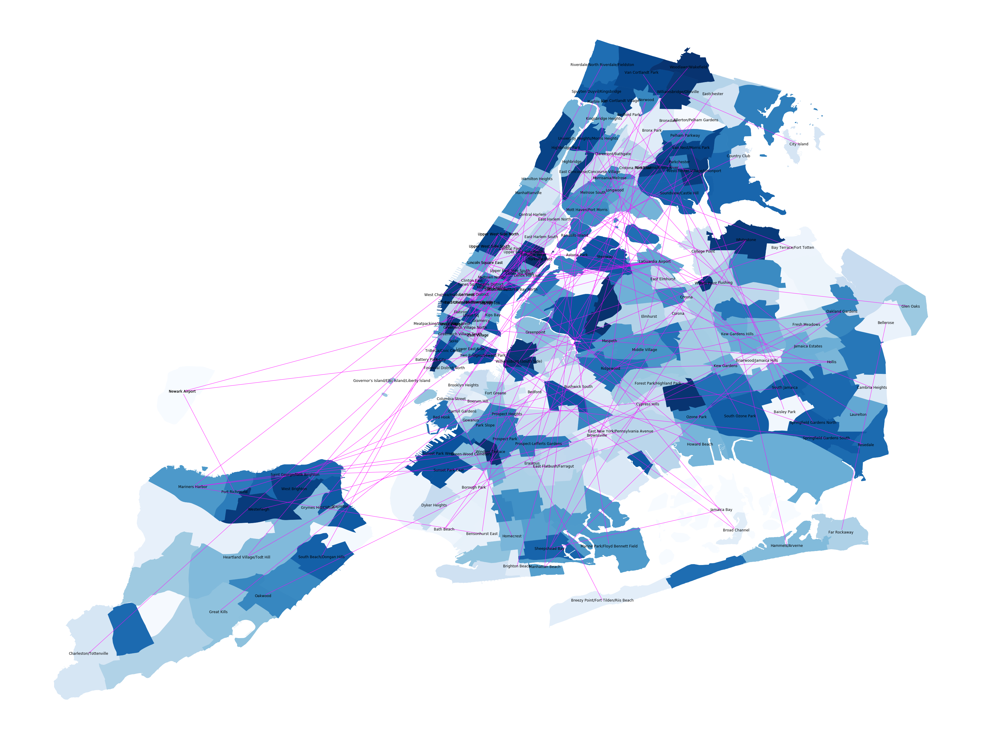

In [26]:
plot_top_bot_n_grpah(df_edge_summary, "hour_var", df_geo)

In [27]:
def plot_monthly(df, G, geo ):
    months_groups = [(12,1,2), (3,4,5), (6,7,8), (9,10,11)]
    season = ["Winter", "Spring", "Summer", "Fall"]
    fig, axs = plt.subplots(ncols = 2, nrows = 2, sharex=True, sharey=True, figsize=(30,30), tight_layout=True)
    i = 0
    j = 0
    for month_group in months_groups:
        columns = [f"month_{i}_count" for i in month_group]
        df_season_counts = df.groupby(by = "pickup_loc_id").sum()[columns].sum(axis = 1).rename("season_count")
        df_season_counts = geo.join(df_season_counts, on = "objectid", how = "inner")
        df_season_counts["season_count"] = np.log(df_season_counts["season_count"].mask(df_season_counts["season_count"] <=0)).fillna(0)
        df_season_counts.plot(
            ax = axs[i][j], 
            column = "season_count",
            cmap = "Blues"
        )
        axs[i][j].axis('off')
        axs[i][j].set_title(season[i * 2 + j], fontsize = 30)

        j += 1
        if j == 2:
            i += 1
            j = 0
    plt.show()
        
    

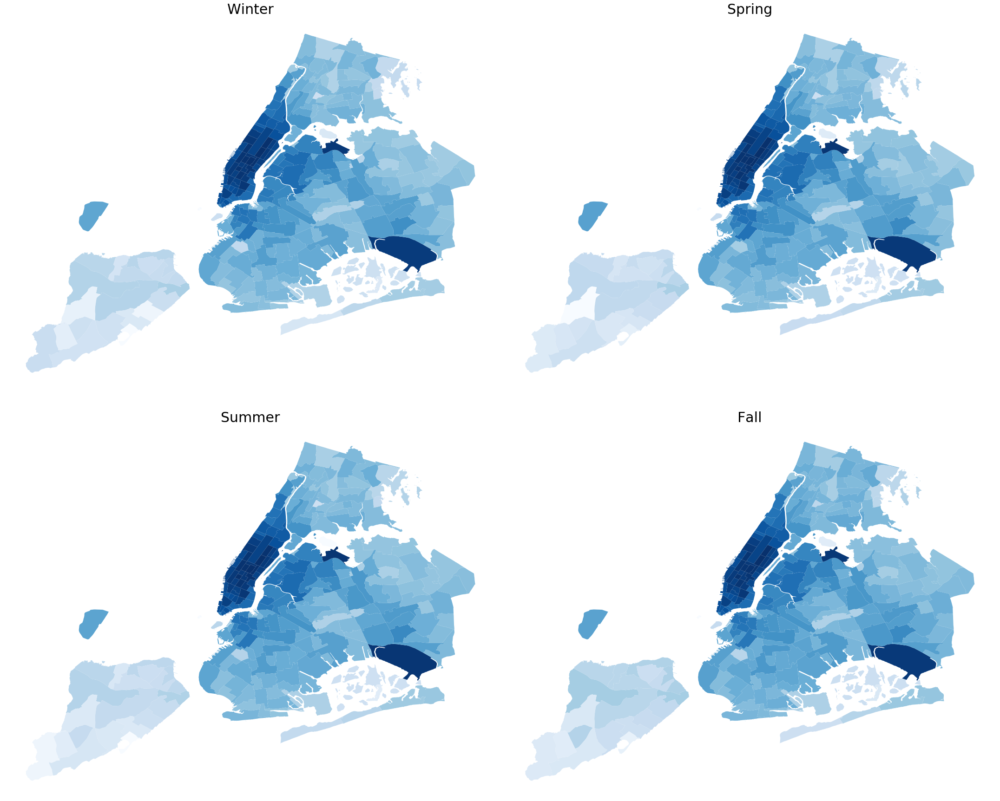

In [28]:
plot_monthly(df_edge_summary, G, df_geo)

In [29]:
def plot_hours(df, G, geo):
    hours_groups = [(6,7,8,9,10,11), (12,13,14,15,16,17), (18,19,20,21,22,23), (0,1,2,3,4,5)]
    hours = ["Morning", "Noon", "Evening", "Night"]
    fig, axs = plt.subplots(ncols = 2, nrows = 2, sharex=True, sharey=True, figsize=(30,30), tight_layout=True)
    i = 0
    j = 0
    for hours_group in hours_groups:
        columns = [f"hour_{i}_count" for i in hours_group]
        df_season_counts = df.groupby(by = "pickup_loc_id").sum()[columns].sum(axis = 1).rename("season_count")
        df_season_counts = geo.join(df_season_counts, on = "objectid", how = "inner")
        df_season_counts["season_count"] = np.log(df_season_counts["season_count"].mask(df_season_counts["season_count"] <=0)).fillna(0)
        df_season_counts.plot(
            ax = axs[i][j], 
            column = "season_count",
            cmap = "Blues"
        )
        axs[i][j].axis('off')
        axs[i][j].set_title(hours[i * 2 + j], fontsize = 30)

        j += 1
        if j == 2:
            i += 1
            j = 0
    plt.show()
        
    

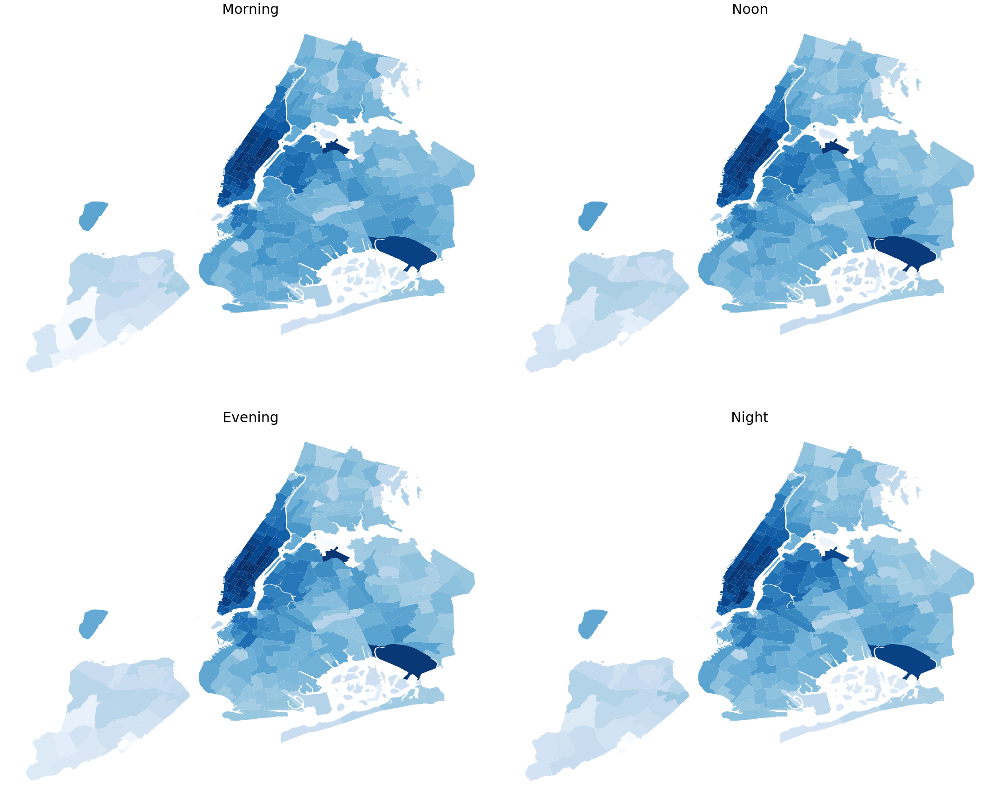

In [30]:
plot_hours(df_edge_summary, G, df_geo)

In [31]:
def map_hours_to_times(time):
    times = [(5,6,7,8,9,10,11), (12,13,14,15,16), (17,18,19,20,21), (22, 23,0,1,2,3,4)]
    if time in times[0]:
        return "Morning (05:00 - 11:59)"
    if time in times[1]:
        return "Day (12:00 - 16:59)"
    if time in times[2]:
        return "Evening (17:00 - 20:59)"  
    if time in times[3]:
        return "Night (21:00 - 04:59)"


def plot_peak_hours(df, G):
    
    fig, (ax1, ax2) = plt.subplots(ncols = 2, sharex=True, sharey=True, figsize=(60,60), tight_layout=True)

    
    peak_hours = df.groupby(by = "pickup_loc_id").sum()[[f"hour_{i}_count" for i in range(24)]].idxmax(axis = 1).rename("peak_hour")
    df_peak_hours = df_geo.join(peak_hours, on = "objectid", how = "inner")
    df_peak_hours["peak_hour"] = df_peak_hours["peak_hour"].str.split("_", expand = True)[1].astype(int).map(map_hours_to_times)
    
    ax1.axis('off')
    ax1.set_title("Most common pickup time by zone",fontsize = 40)
    df_peak_hours.plot(
        ax = ax1,
        edgecolor = "k",
        column = "peak_hour",
        cmap = "viridis_r",
        legend = True,
        legend_kwds = {
            "fontsize": 30,   
            "markerscale": 4,
        }
    )
    
    peak_hours = df.groupby(by = "dropoff_loc_id").sum()[[f"hour_{i}_count" for i in range(24)]].idxmax(axis = 1).rename("peak_hour")
    df_peak_hours = df_geo.join(peak_hours, on = "objectid", how = "inner")
    df_peak_hours["peak_hour"] = df_peak_hours["peak_hour"].str.split("_", expand = True)[1].astype(int).map(map_hours_to_times)
    
    ax2.axis('off')
    ax2.set_title("Most common dropoff time by zone",fontsize = 40)
    df_peak_hours.plot(
        ax = ax2,
        edgecolor = "k",
        column = "peak_hour",
        cmap = "viridis_r",
        legend = True,
        legend_kwds = {
            "fontsize": 30,   
            "markerscale": 4,
        }
    )
    
    
    plt.savefig("hour_peaks.png")


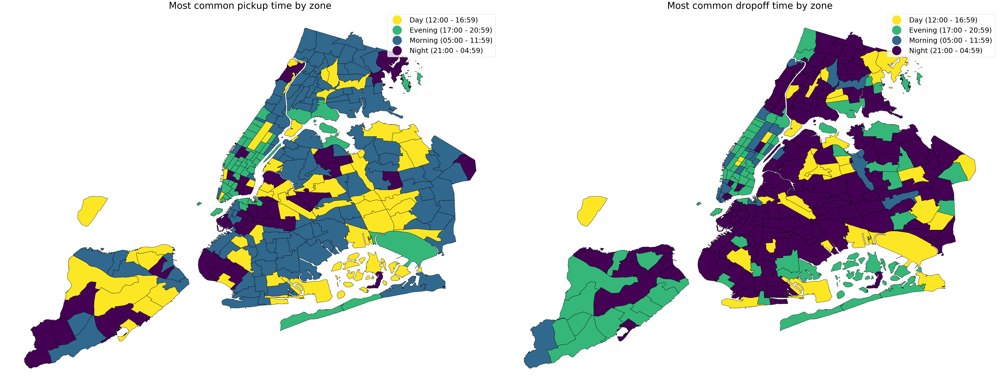

In [32]:
plot_peak_hours(df_edge_summary, G)

In [33]:
def map_months_to_season(time):
    times = [(12,1,2), (3,4,5), (6,7,8), (9,10,11)]
    if time in times[0]:
        return "Winter"
    if time in times[1]:
        return "Spring"
    if time in times[2]:
        return "Summer"  
    if time in times[3]:
        return "Autumn"


def plot_peak_seasons(df, G):
    
    fig, (ax1, ax2) = plt.subplots(ncols = 2, sharex=True, sharey=True, figsize=(60,60), tight_layout=True)

    
    peak_seasons = df.groupby(by = "pickup_loc_id").sum()[[f"month_{i}_count" for i in range(1,13)]].idxmax(axis = 1).rename("peak_season")
    df_peak_seasons = df_geo.join(peak_seasons, on = "objectid", how = "inner")
    df_peak_seasons["peak_season"] = df_peak_seasons["peak_season"].str.split("_", expand = True)[1].astype(int).map(map_months_to_season)
    
    ax1.axis('off')
    ax1.set_title("Most common pickup season by zone",fontsize = 40)
    df_peak_seasons.plot(
        ax = ax1,
        edgecolor = "k",
        column = "peak_season",
        cmap = "Set2",
        legend = True,
        legend_kwds = {
            "fontsize": 30,   
            "markerscale": 4,
        }
    )
    
    peak_seasons = df.groupby(by = "dropoff_loc_id").sum()[[f"month_{i}_count" for i in range(1,13)]].idxmax(axis = 1).rename("peak_season")
    df_peak_seasons = df_geo.join(peak_seasons, on = "objectid", how = "inner")
    df_peak_seasons["peak_season"] = df_peak_seasons["peak_season"].str.split("_", expand = True)[1].astype(int).map(map_months_to_season)
    
    
    ax2.axis('off')
    ax2.set_title("Most common dropoff season by zone",fontsize = 40)
    df_peak_seasons.plot(
        ax = ax2,
        edgecolor = "k",
        column = "peak_season",
        cmap = "Set2",
        legend = True,
        legend_kwds = {
            "fontsize": 30,   
            "markerscale": 4,
        }
    )
    
    
    plt.savefig("season_peaks.png")


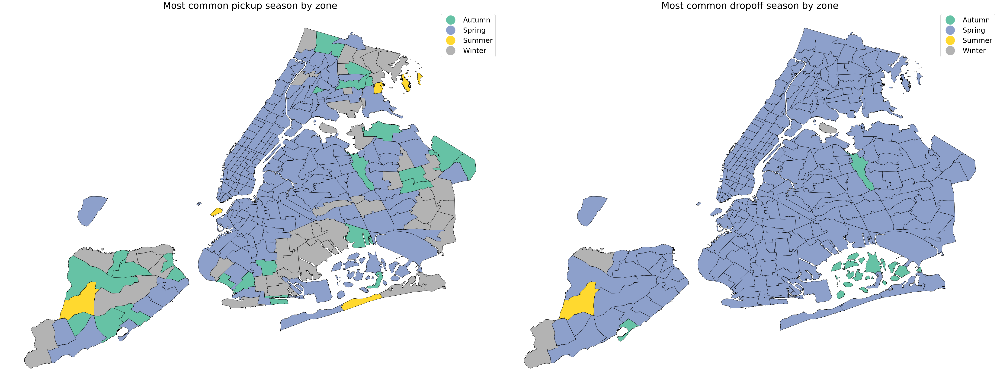

In [34]:
plot_peak_seasons(df_edge_summary, G)

### Research question: Pricing and tipping

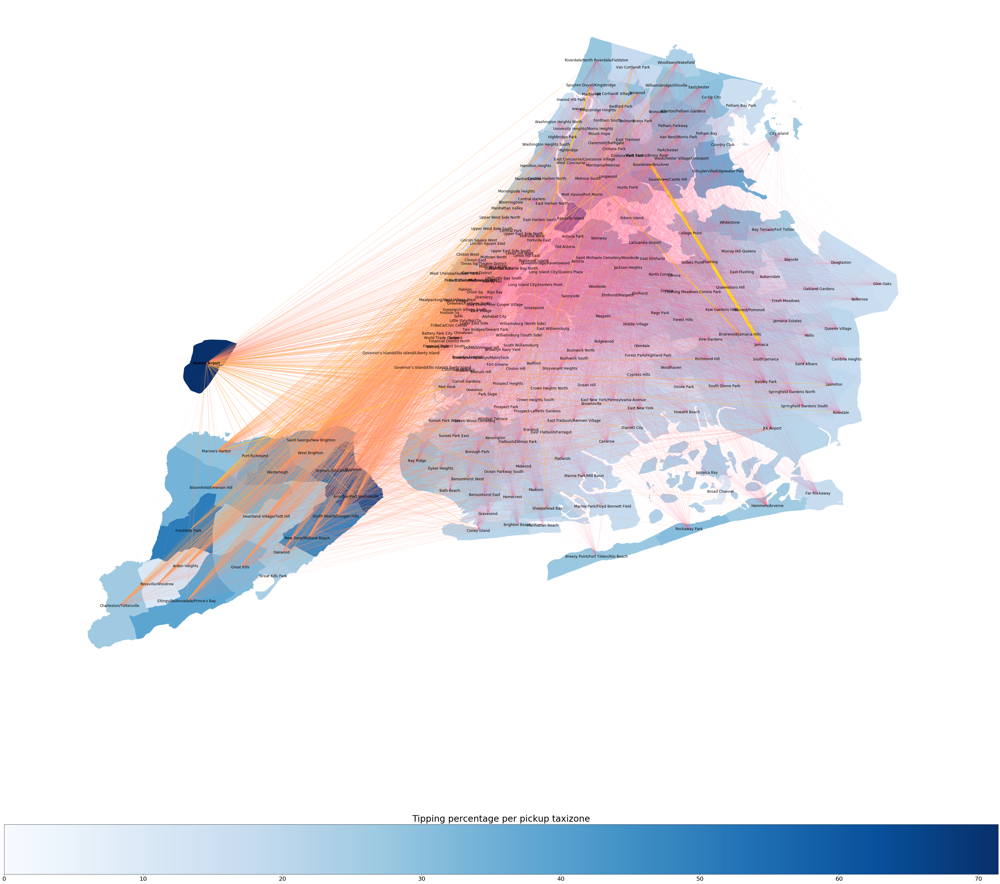

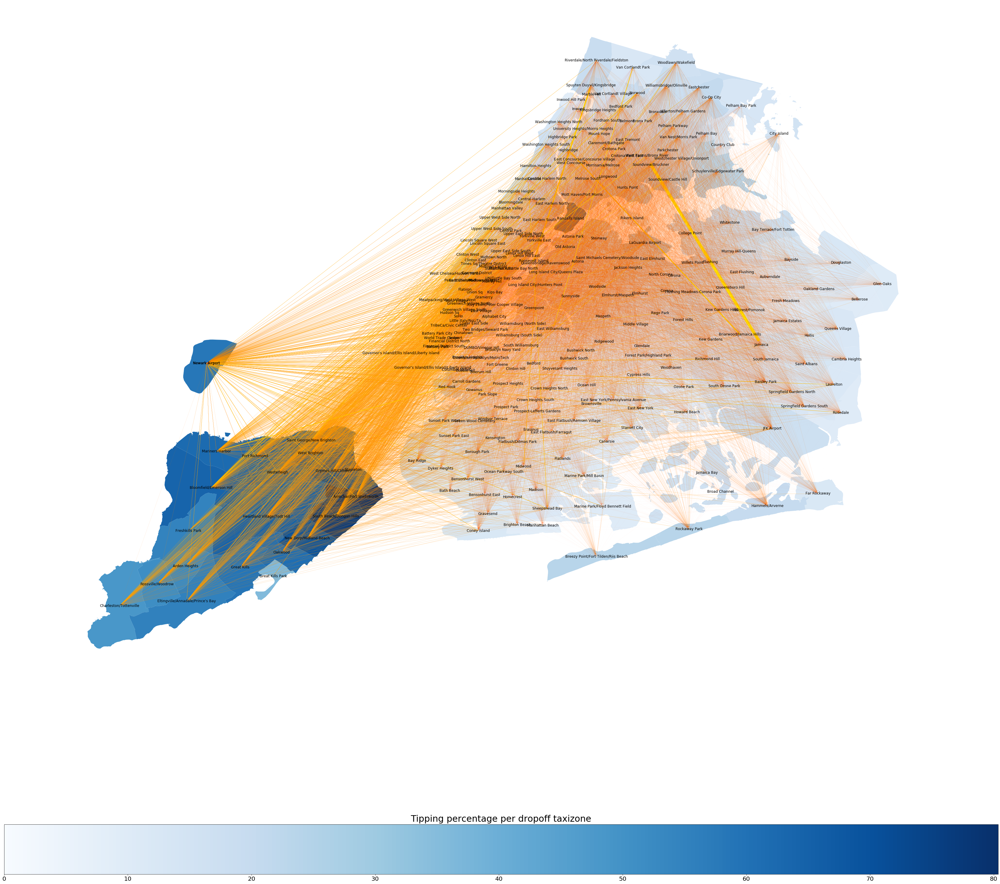

In [35]:
def plot_tip_distribution():
    df_tip_relative = df_edge_summary
    df_tip_relative["tip_percentage"] = df_edge_summary["tip_amount_mean"] / df_edge_summary["total_amount_mean"] * 100
    pickup_loc_tip_mean = df_tip_relative.groupby(by = "pickup_loc_id").mean()["tip_percentage"]
    dropoff_loc_tip_mean = df_tip_relative.groupby(by = "dropoff_loc_id").mean()["tip_percentage"]
    df_geo_pickup_tip_mean = df_geo.merge(pickup_loc_tip_mean, left_on = "objectid", right_on = "pickup_loc_id")
    df_geo_dropoff_tip_mean = df_geo.merge(dropoff_loc_tip_mean,  left_on = "objectid", right_on = "dropoff_loc_id")
    
    colors = scale_to([ (G[a][b]["tip_amount_mean"] + 0.01 / (G[a][b]["total_amount_mean"] + 0.01) + 1) ** 2 for a, b in G.edges()], 0, 1, log = True)
    widths = scale_to([ (abs(G[a][b]["tip_amount_mean"] + 0.01 / (G[a][b]["total_amount_mean"] + 0.01))) ** (1.8) for a, b in G.edges()], 0.0001, 10, log = False)
 
    plt.figure(1,figsize=(60,60)) 
    plt.axis('off')
    nx.draw_networkx_labels(
        G, 
        nx.get_node_attributes(G, "pos"), 
        labels = nx.get_node_attributes(G, "zone"), 
        font_size=12)
    ax = plt.gca()
    ax = df_geo_pickup_tip_mean.plot(
        ax = ax, 
        column = "tip_percentage",
        cmap = "Blues", 
        legend = True,
        legend_kwds={
            'orientation': "horizontal"
        }
    )
    nx.draw_networkx_edges(G, nx.get_node_attributes(G, "pos"), ax = ax, edge_cmap=plt.cm.spring, alpha=1, edge_color=colors, width=widths, edge_vmin=0, edge_vmax=1, arrowsize=1)

    
    ax.figure.axes[1].set_xlabel("Tipping percentage per pickup taxizone", fontsize = 30, labelpad = 10)
    ax.figure.axes[1].xaxis.set_label_position("top")
    ax.figure.axes[1].tick_params(labelsize=20)
    ax.figure.axes[1].set_xticklabels(np.array(range(0, 100, 10), dtype=int))
    plt.savefig("tip_means_pickup.png")
    
    
    plt.figure(2,figsize=(60,60)) 
    plt.axis('off')
    nx.draw_networkx_labels(
        G, 
        nx.get_node_attributes(G, "pos"), 
        labels = nx.get_node_attributes(G, "zone"), 
        font_size=12
    )
    ax = plt.gca()
    ax = df_geo_dropoff_tip_mean.plot(
        ax = ax, 
        column = "tip_percentage", 
        cmap = "Blues", 
        legend = True, 
        legend_kwds={
            'orientation': "horizontal"
        }
    )
    nx.draw_networkx_edges(G, nx.get_node_attributes(G, "pos"), ax = ax, edge_cmap=plt.cm.autumn, alpha=1, edge_color=colors, width=widths, edge_vmin=0, edge_vmax=1, arrowsize=1)
    ax.figure.axes[1].set_xlabel("Tipping percentage per dropoff taxizone", fontsize = 30, labelpad = 10)
    ax.figure.axes[1].xaxis.set_label_position("top")
    ax.figure.axes[1].tick_params(labelsize=20)
    ax.figure.axes[1].set_xticklabels(np.array(range(0,100, 10), dtype=int))
    plt.savefig("tip_means_pickup.png")

plot_tip_distribution()

### Research question: What is the network structure in terms of node degrees, clustering coefficients and density?

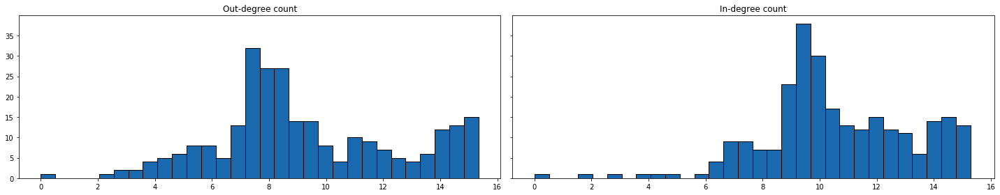

In [36]:
from matplotlib import colors
fig, axs = plt.subplots(1, 2, figsize=(20,4), sharex=True, sharey=True, tight_layout=True)

axs[0].hist(df_geo_pickup_counts["count"], bins=30, color='#1A68AE', edgecolor='k')
axs[1].hist(df_geo_dropoff_counts["count"], bins=30,  color='#1A68AE', edgecolor='k')

axs[0].set_title('Out-degree count')
axs[1].set_title('In-degree count')
plt.show()

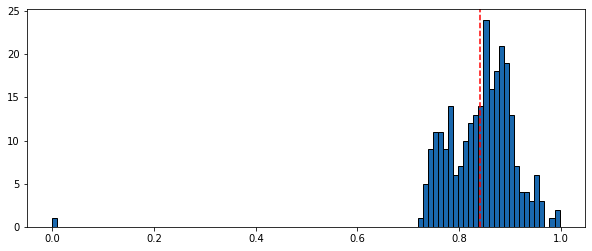

In [37]:
plt.figure(figsize=(10,4))
plt.hist(nx.clustering(G).values(), bins=100, edgecolor='k', color='#1A68AE')

plt.axvline(nx.average_clustering(G), color='r', linestyle='dashed', linewidth=1.5)
plt.show()

In [38]:
from networkx.classes.function import density

dens = density(G)

multidens = sum(df_edge_summary["count"]) / (len(G.nodes) * (len(G.nodes)-1)) 

print("Density is: ", dens)
print("Density when network is considered a multigraph: ", multidens)

Density is:  0.6979058647309598
Density when network is considered a multigraph:  1616.393075239083
